# Toxics Release Inventory (TRI) Overview

The U.S. Environmental Protection Agency (EPA) TRI Program was created through the 1986 Emergency Planning and Community Right-to-Act (EPCRA) to provide information about air, land, and water releases of toxic chemicals from industrial and federal facilities. The current ***TRI toxic chemicals list contains 794 individually listed chemicals and 33 chemical categories***. Specific industrial sectors are required to report to the TRI Program and are identified by six-digit North American Classification System (NAICS) codes. Data are reported annually. Refer to the TRI Program Home (https://www.epa.gov/toxics-release-inventory-tri-program) for reporting requirements and further information.

## Objectives of this Platform


This interactive platform was developed to provide information about TRI air emissions (stack + fugitive) from faciltiies in SETx counties (Jefferson, Orange, Hardin, Jasper, Newton) for a user-selected year beginning in 1987. TRI data are obtained directly from the EPA through the TRI Basic Data Files: https://www.epa.gov/toxics-release-inventory-tri-program/tri-basic-data-files-calendar-years-1987-present. 

The platform was designed to enable DOE SETx-UIFL project team members to: 
1. easily ingest annual TRI air data
2. conduct analyses relevant to air quality and cross-theme research 
3. provide supporting information for interactions with stakeholders in SETx.


#### Using the platform, you can determine:
1. Air emissions in total and by individual counties in Texas
2. TRI-listed chemicals and their quantitites emitted in SETx
3. Industrial sectors and facilities that contribute to emissions of all or selected chemicals in SETx
4. Chemical profiles of emissions from industrial sectors in SETx
5. Chemical profiles of emissions from indiviudal facilities in SETx 


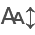

In [1]:
import pandas as pd
import geopandas as gpd
from itables import init_notebook_mode
import ipywidgets as widgets
from ipywidgets import interact,fixed
pd.set_option('display.max_colwidth', 10)
init_notebook_mode(all_interactive=True)
%matplotlib inline
import folium
import matplotlib.pyplot as plt
import re

def remove_numbers_and_hyphen_with_space(text):
     return re.sub(r'\d+\. ', '', text)

In [2]:
## Plotly Libraries
#  Get figures to actually render in notebook [issue](https://github.com/MaartenGr/BERTopic/issues/764)
import plotly.express as px
import plotly.io as pio
pio.renderers.default='iframe_connected'

## Read Files

### Select a TRI Year of Interest (1987 - Most Recent Available Release)

In [3]:
year = slider = widgets.IntSlider(
    value=2022,
    min=1987,
    max=2022,
    step=1,
    description='Year of Emissions:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

region = widgets.Dropdown(
    options=["TX", 'US'],
    value='TX',
    description='Region of Interest',
    disabled=False,
)
display(year)
region

IntSlider(value=2022, continuous_update=False, description='Year of Emissions:', max=2022, min=1987)

Dropdown(description='Region of Interest', options=('TX', 'US'), value='TX')

### TRI BASICS DOWNLOAD
*Note the most recent emission inventory data can be subject to updates by EPA.*

In [4]:
TRI = pd.read_csv(f'https://data.epa.gov/efservice/downloads/tri/mv_tri_basic_download/{year.value}_{region.value}/csv')

naics = pd.read_excel("2022_NAICS_Descriptions.xlsx")
counties = gpd.read_file('Texas_County_Boundaries_Detailed_-8523147194422581030.geojson')
TRI.columns= [remove_numbers_and_hyphen_with_space(c) for c in TRI.columns]
TRI['NAICs 6-digit']= TRI['PRIMARY NAICS']


/var/folders/ps/dx2yrk_1117grf32kqlw9qyh0000gq/T/ipykernel_32506/3717925765.py:1: DtypeWarning:

Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.



### Join Tables, Adjust Size of columns

In [5]:
TRI = TRI.join(naics.set_index("Code"), on="PRIMARY NAICS")
TRI['NAICs Description']= TRI['Title']
TRI['CHEMICAL']= TRI.apply(lambda x: x['CHEMICAL'][:100], axis=1)
counties['Counties']=(counties.CNTY_NM.str.upper())


## Calculate Total Air Emissions (Stack + Fugitive) by Chemical for Each Texas Facility 

In [6]:
def calculate_Total_Air(x):
    if x['UNIT OF MEASURE']=='Pounds':
        return x['5.1 - FUGITIVE AIR']+x['5.2 - STACK AIR']
    else:
        return (x['5.1 - FUGITIVE AIR']+x['5.2 - STACK AIR'])/453.592 #Note dioxin converted from grams to pounds
TRI['Total Air (lbs)']= TRI.apply(lambda x: calculate_Total_Air(x), axis=1)
TRI['Total Air (Tons)']=TRI['Total Air (lbs)']/2000


## Calculate Total Air Emissions in Texas
Sum of stack and fugitive emissions (pounds; tons) from all Texas facilities for selected year

In [7]:
print(f"Texas Total (lbs) = {TRI['Total Air (lbs)'].sum() :,} ")
print(f"Texas Total (Tons)= {TRI['Total Air (Tons)'].sum() :,} ")

Texas Total (lbs) = 54,095,824.69052964 
Texas Total (Tons)= 27,047.912345264813 


In [8]:
county_df = pd.DataFrame()
county_df['County'] = TRI['COUNTY'].unique()
for g in TRI.groupby('COUNTY'):
    county_df.loc[county_df['County']==g[0], 'TRI 2022 Air Total (pounds)']=g[1]['Total Air (lbs)'].sum()
county_df['TRI 2022 Air Total (Tons)']=county_df['TRI 2022 Air Total (pounds)']/2000
county_df['TRI Air Release Total (County Rank)']=county_df['TRI 2022 Air Total (Tons)'].rank(ascending=False)
tri_counties = counties.join(county_df.set_index('County'), on = 'Counties').reset_index()
tri_counties.fillna(0, inplace = True)

## Total Air Emissions by Texas County
Ranking of Total Air Emissions (lbs; Tons) for Texas Counties TRI. 
#### Select column to order ascending/descending

In [9]:
county_df

County  TRI 2022 Air Total (pounds)  TRI 2022 Air Total (Tons)  \
0    GALVESTON  1.7173...                    858.68...                   
1     BRAZORIA  3.2967...                    1648.3...                   
2       HARRIS  1.0879...                    5439.6...                   
3    GLASSCOCK  4.7014...                    23.507120                   
4        BEXAR  2.1096...                    105.48...                   
..         ...        ...                          ...                   
170  SCHLEI...  1.2510...                     0.625500                   
171   MITCHELL  0.0000...                     0.000000                   
172  VAL VERDE  2.3000...                     0.001150                   
173      TYLER  1.0000...                     0.000050                   
174   HARDEMAN  8.9000...                     0.000445                   

     TRI Air Release Total (County Rank)  
0          9.0                            
1          4.0                            
2          1.0                            
3         74.0                            
4         32.0                            
..         ...                            
170      148.0                            
171      172.0                            
172      164.0                            
173      167.0                            
174      166.0                            

[175 rows x 4 columns]

## Map TRI Emissions (Tons) by Texas County 

In [10]:
from branca.colormap import LinearColormap

# Create a map centered on Texas
m = folium.Map(location=[31, -100], zoom_start=6)
breaks = [0, 100, 200, 500, 1000, 2500, 5000]
colors = ['#00FF00', '#66FF00', '#CCFF00', '#FFFF00', '#FFCC00', '#FF6600', '#FF0000']
# Create a color map with custom breaks
# colormap = LinearColormap(colors=colors, vmin=0, vmax=5000)
# colormap.index = breaks
colormap = LinearColormap(colors=colors, vmin=0, vmax=5000, index=breaks)

# Add the counties to the map
folium.GeoJson(
    tri_counties,
    style_function=lambda feature: {
        'fillColor': colormap(min(feature['properties']['TRI 2022 Air Total (Tons)'], 5000)),
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.7,
    },
    tooltip=folium.GeoJsonTooltip(fields=['CNTY_NM', 'TRI 2022 Air Total (Tons)'])
).add_to(m)


# Create a custom legend with responsive sizing
legend_html = '''
<div style="position: fixed; bottom: 50px; left: 50px; width: 220px; height: 180px;
border:2px solid grey; z-index:9999; font-size:14px; background-color:white;
">&nbsp; TRI 2022 Air Total (Tons)<br>
&nbsp; <i style="background:#00FF00; display:inline-block; width:10px; height:10px;"></i>&nbsp;0 - 100<br>
&nbsp; <i style="background:#66FF00; display:inline-block; width:10px; height:10px;"></i>&nbsp;100 - 200<br>
&nbsp; <i style="background:#CCFF00; display:inline-block; width:10px; height:10px;"></i>&nbsp;200 - 500<br>
&nbsp; <i style="background:#FFFF00; display:inline-block; width:10px; height:10px;"></i>&nbsp;500 - 1,000<br>
&nbsp; <i style="background:#FFCC00; display:inline-block; width:10px; height:10px;"></i>&nbsp;1,000 - 2,500<br>
&nbsp; <i style="background:#FF6600; display:inline-block; width:10px; height:10px;"></i>&nbsp;2,500 - 5,000<br>
&nbsp; <i style="background:#FF0000; display:inline-block; width:10px; height:10px;"></i>&nbsp;5,000+
</div>
'''



# Add the custom legend to the map
m.get_root().html.add_child(folium.Element(legend_html))

# Display the map
display(m)

## Air Emissions and Ranking by Chemical, Industrial Sector, or Facility for SETx Counties 

In [11]:
setx_counties = ['JASPER', 'JEFFERSON', 'ORANGE', 'HARDIN', 'NEWTON' ]
dropdown = widgets.Dropdown(
    options=[ 'CHEMICAL','NAICs Description', "FACILITY NAME"],
    value='CHEMICAL',
    description='Group by:',
    disabled=False,
)
slider = widgets.IntSlider(
    value=20,
    min=0,
    max=252,
    step=5,
    description='Top Emmissions:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)


box = widgets.Box([dropdown, slider])


#### Select Emissions Ranking by Chemical, North American Industry Classification System (NAICS) Description, or Facility

In [12]:
def create_chart_plotly(group, number_of_members, setx=True):
    # Use inputs to format chart data
    if setx:
        chemical = TRI.loc[TRI['COUNTY'].isin(setx_counties)].groupby(group)['Total Air (Tons)'].sum()
    else: 
        chemical = TRI.groupby(group)['Total Air (Tons)'].sum()
    length = len(chemical)
    plot_data = chemical.loc[chemical> 0].sort_values(ascending=False).head(number_of_members)

    # Set chart title per inputs
    if setx: 
        plot_title = f'2022 Annual Emissions of TRI-Listed Chemicals ({number_of_members}  of {length} reported) in SETx'
    else: 
        plot_title = f'2022 Annual Emissions of TRI-Listed Chemicals ({number_of_members} of {length} reported) in Texas'

    # Generate chart
    bar_plot = px.bar(plot_data, x=plot_data.index, y='Total Air (Tons)', log_y=True, title = plot_title)

    # Update the layout of the chart including labeling, size, etc. Size lines currently commented out.
    bar_plot.update_layout(xaxis_tickangle=45,
        yaxis_title='Log Total Air (Tons)',
        width=1200,
        height=800
    )
    
    bar_plot.show()

In [13]:
interact(create_chart_plotly, group=dropdown, number_of_members=slider, setx=True);

interactive(children=(Dropdown(description='Group by:', options=('CHEMICAL', 'NAICs Description', 'FACILITY NA…

## Industrial Sector Chemical Profiles in SETx-UIFL

In [14]:
from ipywidgets import  Dropdown,Layout

geo = {'CHEMICAL':['NAICs Description', "FACILITY NAME"],
       'NAICs Description':['CHEMICAL'],
         'FACILITY NAME':['CHEMICAL']}



row = Dropdown(options = geo.keys(),
                description='Select what you want to profile ',
                align_items='stretch',
                
                 style= {'description_width': 'initial'} )
init = row.value
columns = Dropdown(options=geo[init],
                    description='Select how you want it profiled ',
                    align_items='stretch',
                     style= {'description_width': 'initial'} )
selection  = widgets.SelectMultiple(
    options=TRI.loc[(TRI['COUNTY'].isin(setx_counties)),'NAICs Description'].unique(),
    value=['Paperboard Mills', 'Petrochemical Manufacturing'],
)


def display_NAICS_profile( row, column, NAICs  ):
    display(f'Select which {row} to profile by {column} sector.',)
    columns.options = geo[row] 
    try:
        display(TRI.loc[(TRI['COUNTY'].isin(setx_counties)) & (TRI['NAICs Description'].isin(NAICs))& (TRI['CHEMICAL'])].pivot_table(index=row, 
                    columns=column, values='Total Air (Tons)', aggfunc='sum', fill_value=0))
    except Exception:
        pass





In [15]:

display(interact(display_NAICS_profile, NAICs=selection, row=row,  column=columns))



interactive(children=(Dropdown(description='Select what you want to profile ', options=('CHEMICAL', 'NAICs Des…

<function __main__.display_NAICS_profile(row, column, NAICs)>